In [137]:
import scanpy as sc
import pandas as pd
import anndata
import numpy as np

sc.set_figure_params(dpi=300,dpi_save=300)
sc.settings.figdir = "hypo_gene_plots"

In [4]:
zeb_data = sc.read_mtx("comb_logcounts.mtx")

In [5]:
zeb_logcounts = zeb_data.X 
zeb_data = anndata.AnnData(X=zeb_logcounts.T)

In [6]:
zeb_genes = pd.read_csv("comb_sce_genes.tsv")
zeb_data.var.index = zeb_genes["x"]

In [52]:
zeb_data

AnnData object with n_obs × n_vars = 223037 × 15466
    obs: 'orig.ident', 'stage', 'cluster', 'celltype', 'celltype_markers', 'sizeFactor'
    uns: 'celltype_colors'
    obsm: 'X_pca', 'X_umap'

In [53]:
del zeb_data.uns

In [59]:
del zeb_data.obs

In [60]:
zeb_coldata = pd.read_csv("comb_sce_coldata.tsv", sep="\t")
zeb_data.obs = zeb_coldata

In [80]:
zeb_celltypes = pd.read_csv("comb_sce_celltypes.tsv", sep="\t")
zeb_celltypes.index = zeb_data.obs.index
zeb_data.obs["celltype"] = zeb_celltypes["x"]

broad_celltypes = pd.read_csv("comb_sce_broad_celltypes.tsv", sep="\t")
broad_celltypes.index = zeb_data.obs.index
zeb_data.obs["broad_celltype"] = broad_celltypes["x"]

In [9]:
zeb_data.obsm["X_pca"] = np.array(pd.read_csv("corrected_pcs_wnorm.tsv", sep="\t"))

In [10]:
zeb_data.obsm["X_umap"] = np.array(pd.read_csv("comb_umap.tsv", sep="\t"))

In [75]:
zeb_data.obs['celltype'] =zeb_data.obs['celltype'].cat.rename_categories(zeb_data.obs['celltype'].unique())

In [83]:
zeb_data.obs

,orig.ident,stage,cluster,celltype,celltype_markers,sizeFactor,broad_celltype
s01-12h_AAACCTGAGCCACGCT,s01-12h,12 hpf,0,optic vesicle,Unknown,7.802603,Optic
s01-12h_AAACCTGAGCTAACTC,s01-12h,12 hpf,12,dorsal diencephalon,"emx3, foxg1a, ntn1b, sox1b, hesx1, rspo3, fezf...",12.411286,Diencephalon
s01-12h_AAACCTGAGGCAGTCA,s01-12h,12 hpf,0,optic vesicle,Unknown,3.112842,Optic
s01-12h_AAACCTGAGTTAGCGG,s01-12h,12 hpf,13,telencephalon I (neurons),"hand2, gata5, tdgf1, gdf3, gata6, foxh1, nkx2....",7.689640,Telencephalon
s01-12h_AAACCTGAGTTCGCGC,s01-12h,12 hpf,3,Unknown,"eng2a, her5, her11, eng2b, pax2a, ackr3a, pax7...",11.375493,Unknown
...,...,...,...,...,...,...,...
s70-15d_TTTGTCAGTCGCGAAA,s70-15d,15 dpf,0,optic tectum (gabaergic) neurons,Unknown,0.760018,Optic
s70-15d_TTTGTCAGTCTGATTG,s70-15d,15 dpf,18,diencephalon (gabaergic) neurons,"krt97, tp63, klf17, dlx3b, vgll4l, msx1b, ptgs...",1.634163,Diencephalon
s70-15d_TTTGTCAGTGATAAAC,s70-15d,15 dpf,64,dorsal habenula,"cldni, pfn1, thy1, tagln2, spaca4l, cyp2k16, t...",0.989925,Other
s70-15d_TTTGTCAGTTACTGAC,s70-15d,15 dpf,3,neurons (glutamatergic),"eng2a, her5, her11, eng2b, pax2a, ackr3a, pax7...",0.865875,Other neurons


In [12]:
zeb_data.write("comb_anndata.h5ad")

/hps/software/users/marioni/dkeitley/miniconda3/envs/pyenv/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'orig.ident' as categorical
... storing 'stage' as categorical
... storing 'celltype' as categorical
... storing 'celltype_markers' as categorical


In [ ]:
sc.pp.neighbors(zeb_data)
sc.tl.umap(zeb_data)

/hps/software/users/marioni/dkeitley/miniconda3/envs/pyenv/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 10002. The TBB threading layer is disabled.
  warnings.warn(problem)


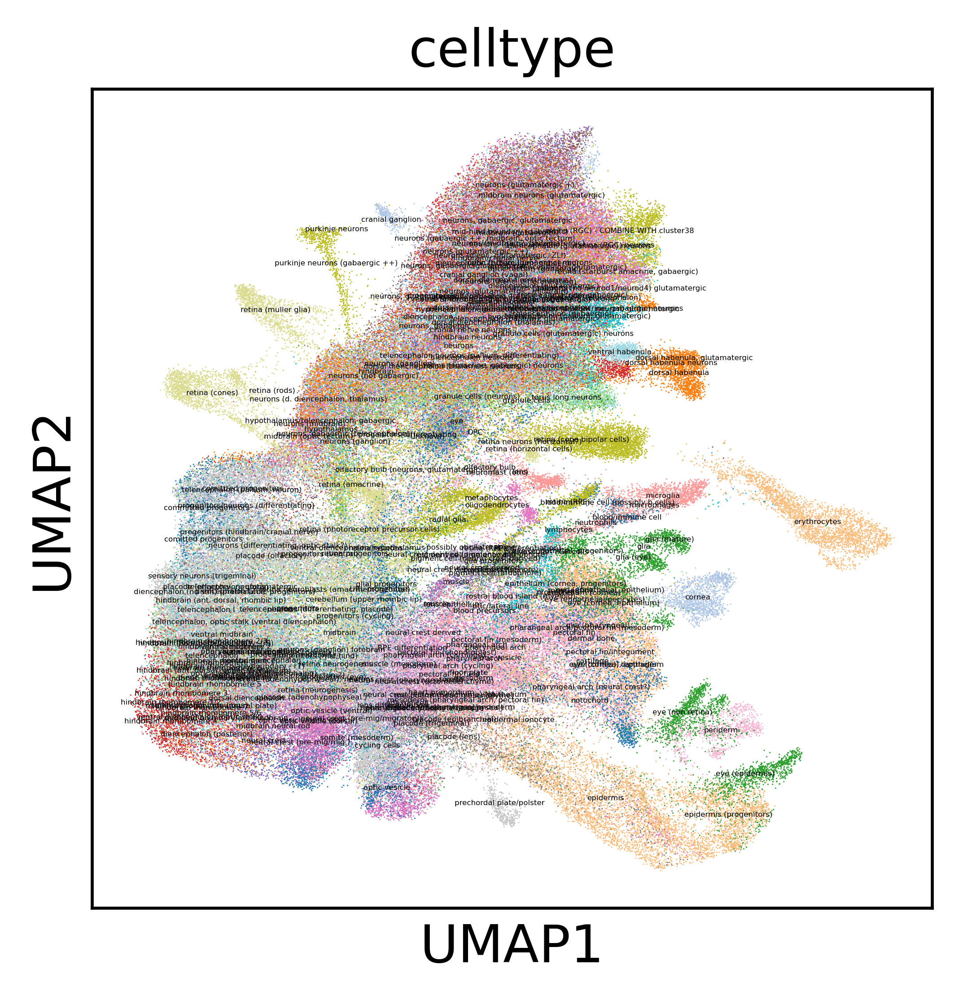

In [84]:
sc.pl.umap(zeb_data,color="celltype", legend_loc="on data", legend_fontsize=2, legend_fontweight="light")

/hps/software/users/marioni/dkeitley/miniconda3/envs/pyenv/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'celltype' as categorical
... storing 'broad_celltype' as categorical


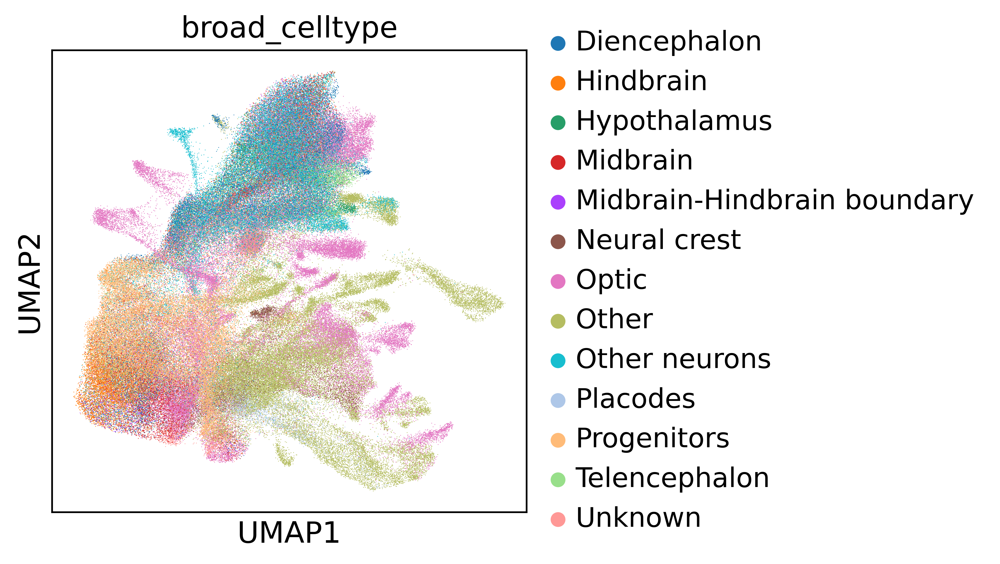

In [82]:
sc.pl.umap(zeb_data,color="broad_celltype")

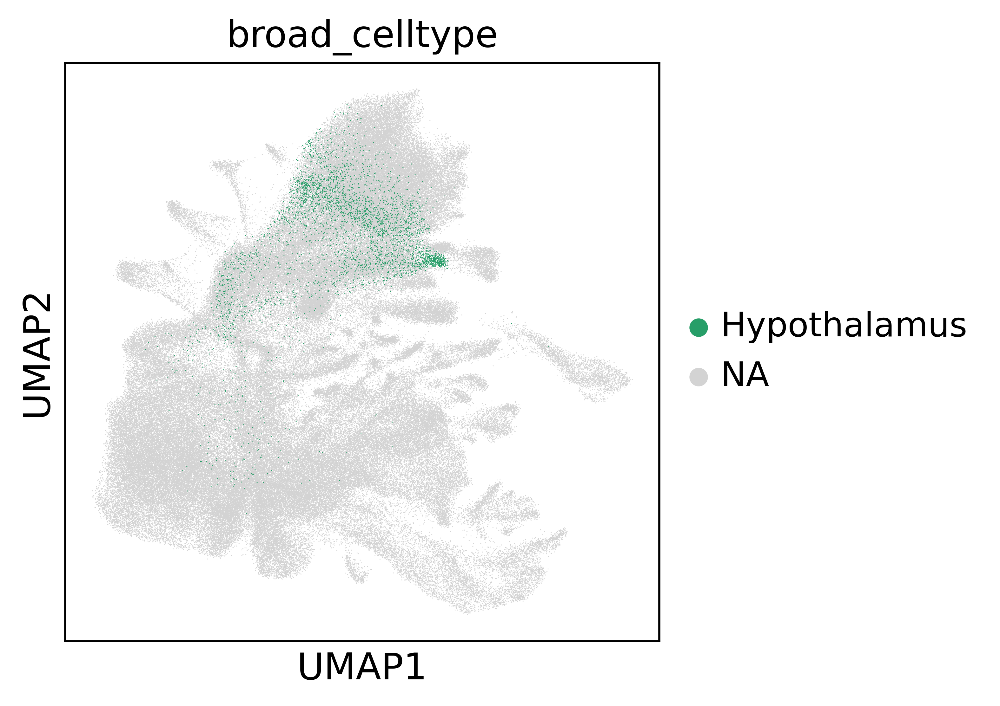

In [85]:
sc.pl.umap(zeb_data,color="broad_celltype",groups=["Hypothalamus"])

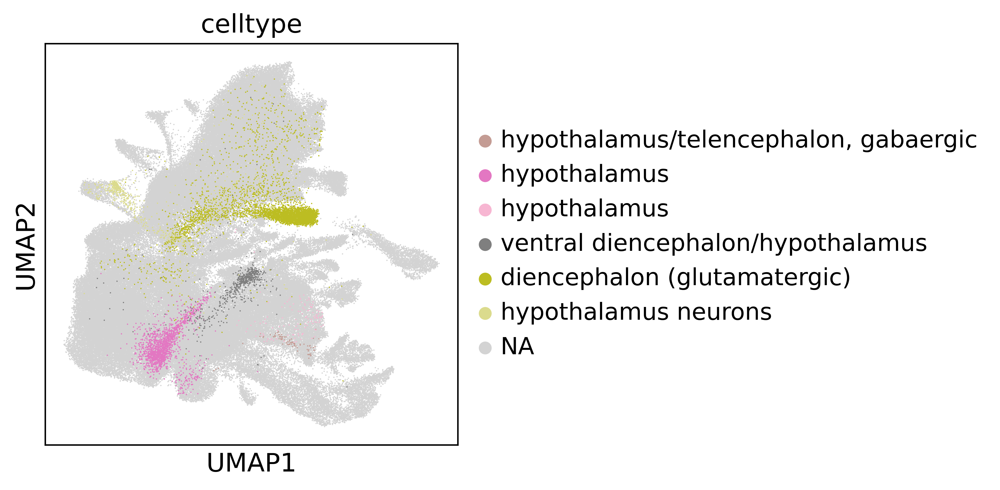

In [76]:
sc.pl.umap(zeb_data,color="celltype", groups=["hypothalamus", "hypothalamus/telencephalon, gabaergic", 
                                              "hypothalamus ", "ventral diencephalon/hypothalamus", 
                                              "hypothalamus neurons", 
                                              "diencephalon (glutamatergic)"], palette="tab20", size=2)

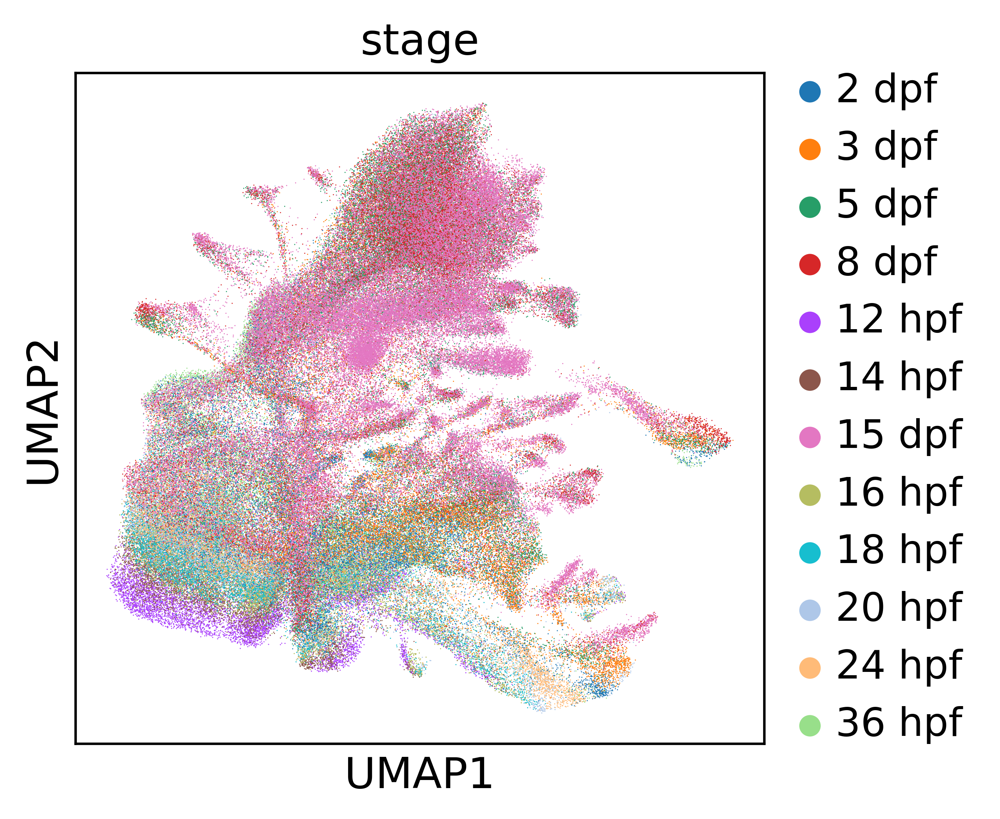

In [68]:
sc.pl.umap(zeb_data,color="stage")

In [40]:
sc.pl.umap(zeb_data,color=["hmx2","hmx3a", "otpa", "otpb", "bsx", "fezf2", "nkx2.1","six3a", "rx3"], color_map="viridis_r",size=2)

In [115]:
zeb_hypo = zeb_data[zeb_data.obs["broad_celltype"]=="Hypothalamus",]
zeb_hypo

/hps/software/users/marioni/dkeitley/miniconda3/envs/pyenv/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


View of AnnData object with n_obs × n_vars = 4370 × 15466
    obs: 'orig.ident', 'stage', 'cluster', 'celltype', 'celltype_markers', 'sizeFactor', 'broad_celltype'
    uns: 'celltype_colors', 'stage_colors', 'broad_celltype_colors'
    obsm: 'X_pca', 'X_umap'

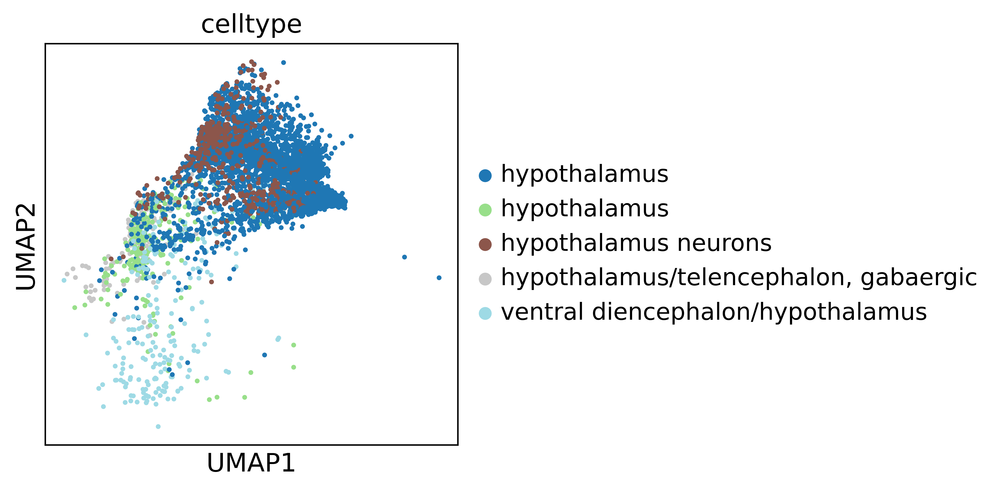

In [102]:
sc.pl.umap(zeb_hypo,color=["celltype"],palette="tab20")

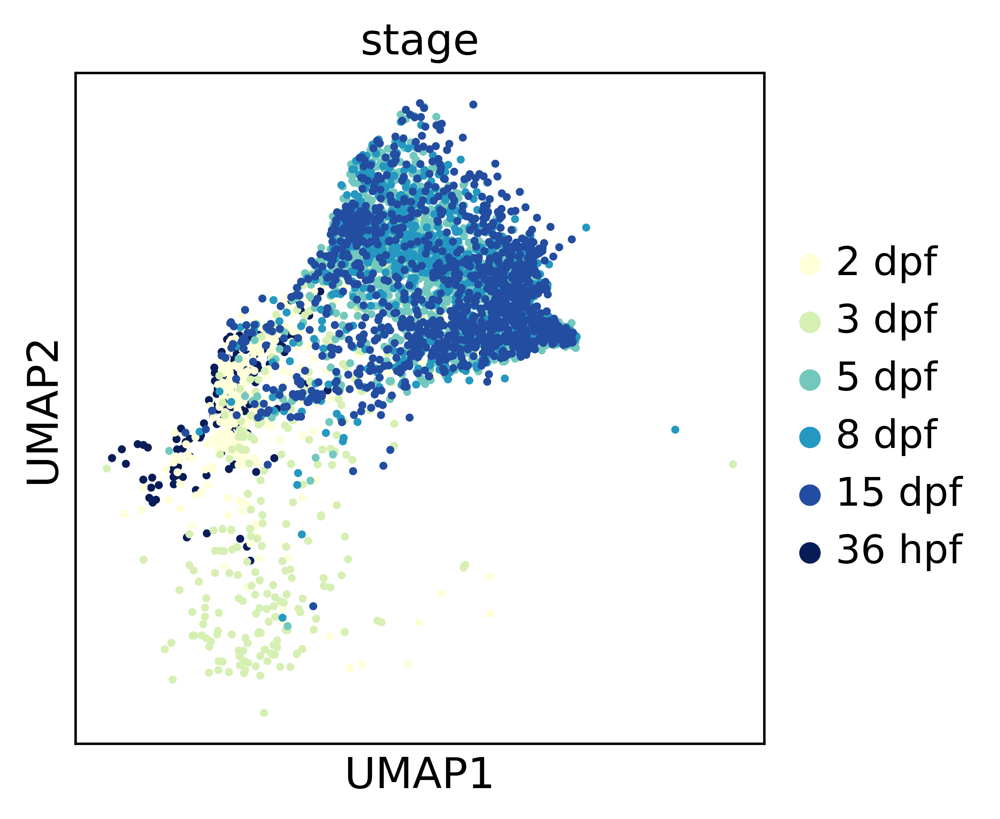

In [101]:
sc.pl.umap(zeb_hypo,color=["stage"], palette="YlGnBu")

In [135]:
zeb_hypo.var[zeb_hypo.var.index == "slc6a4a"]

""
x


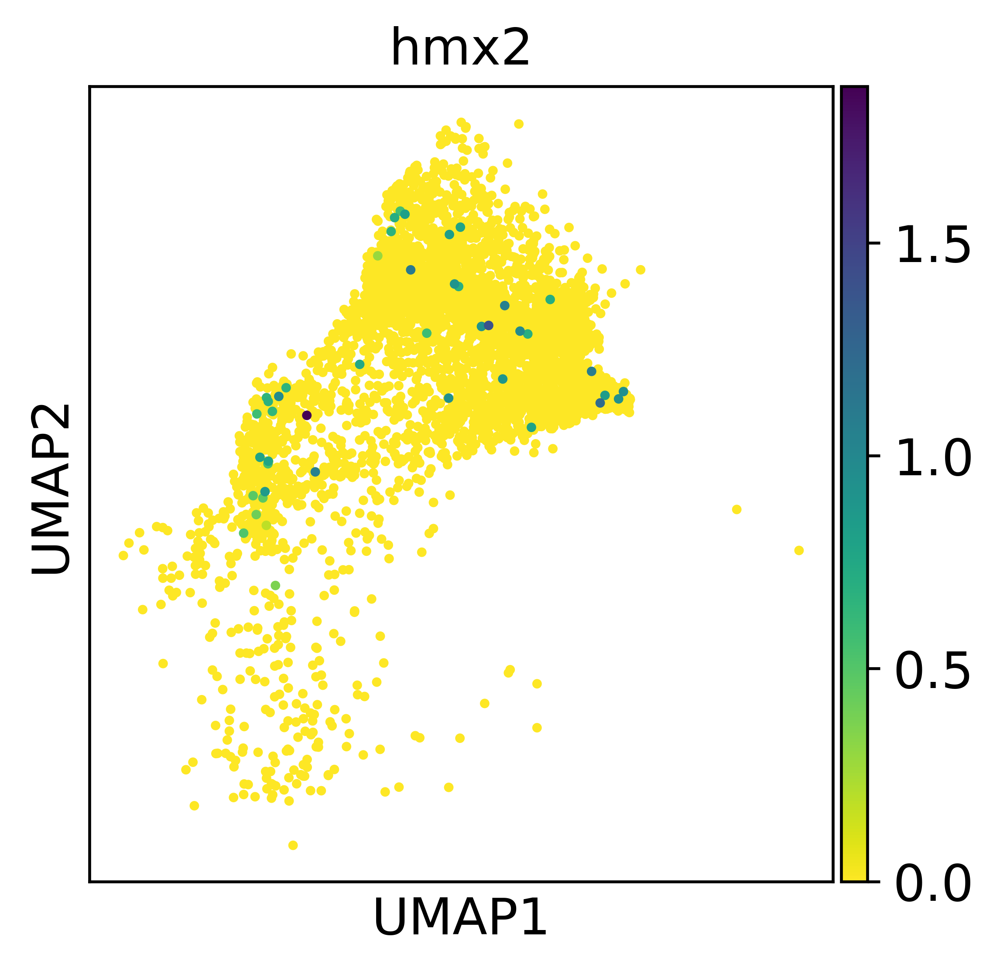

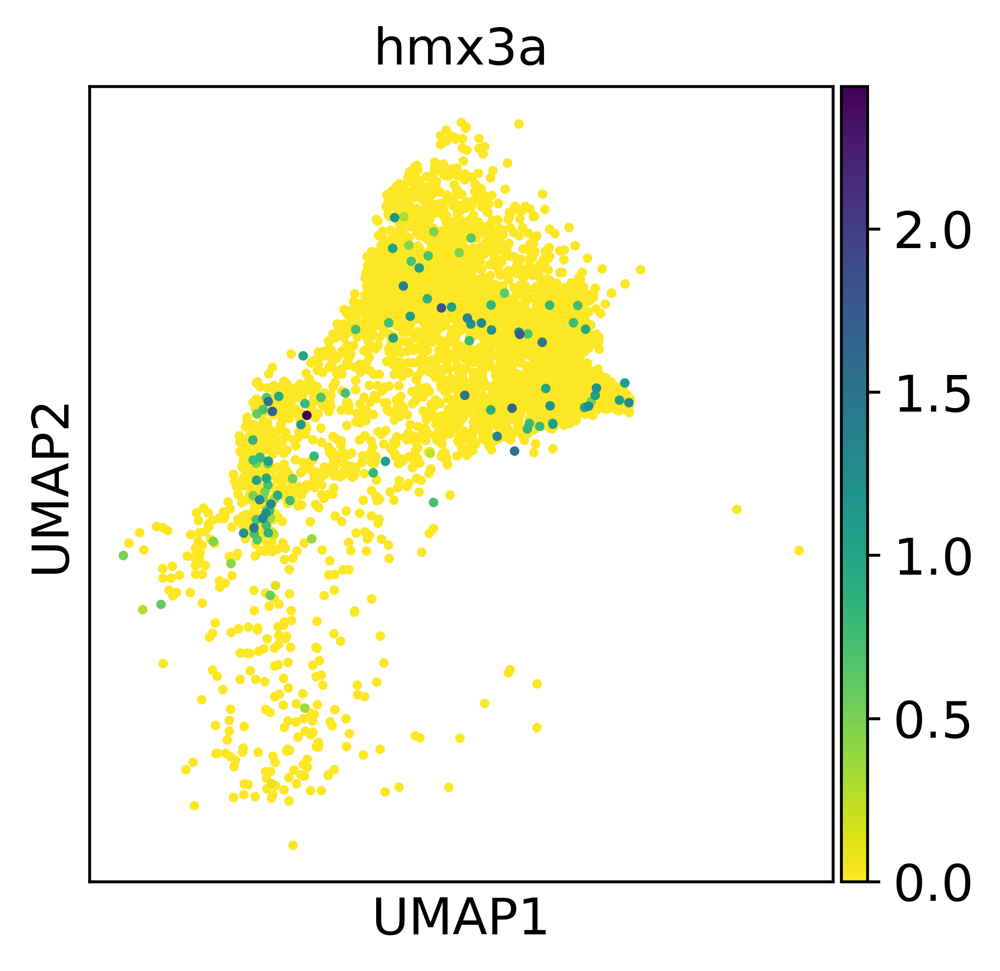

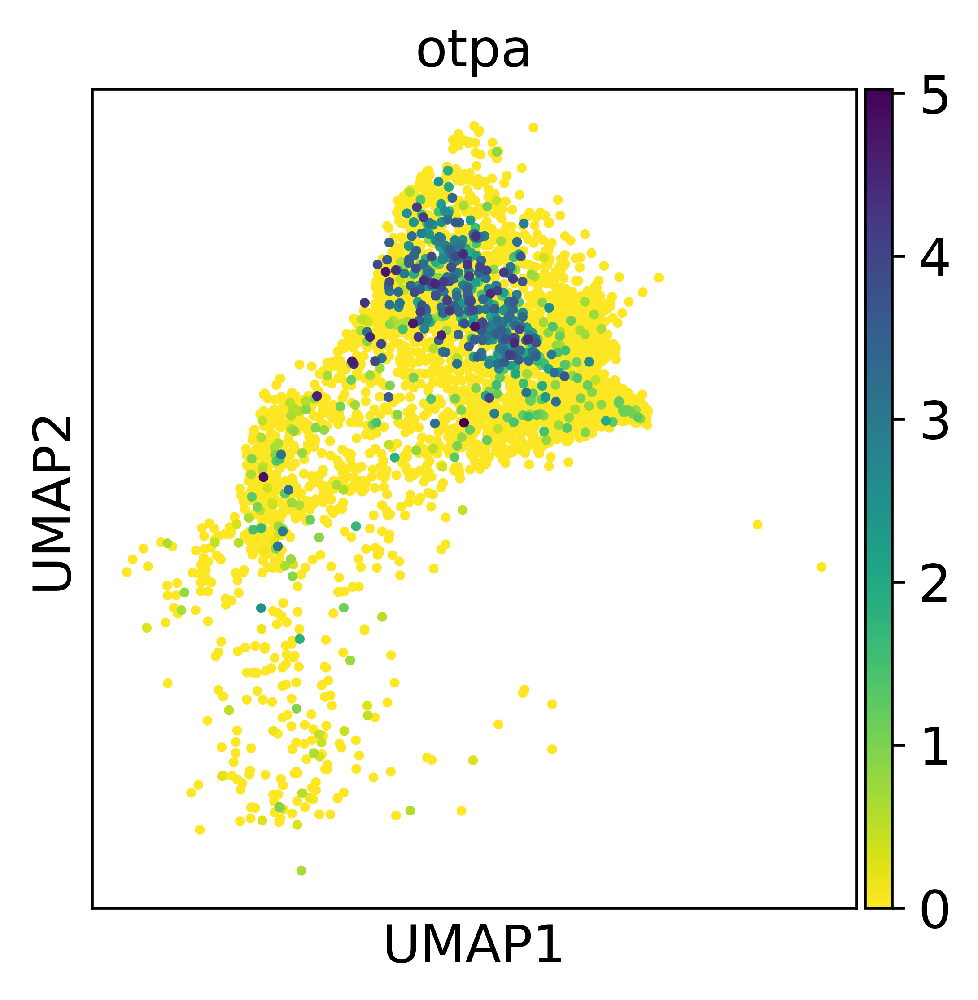

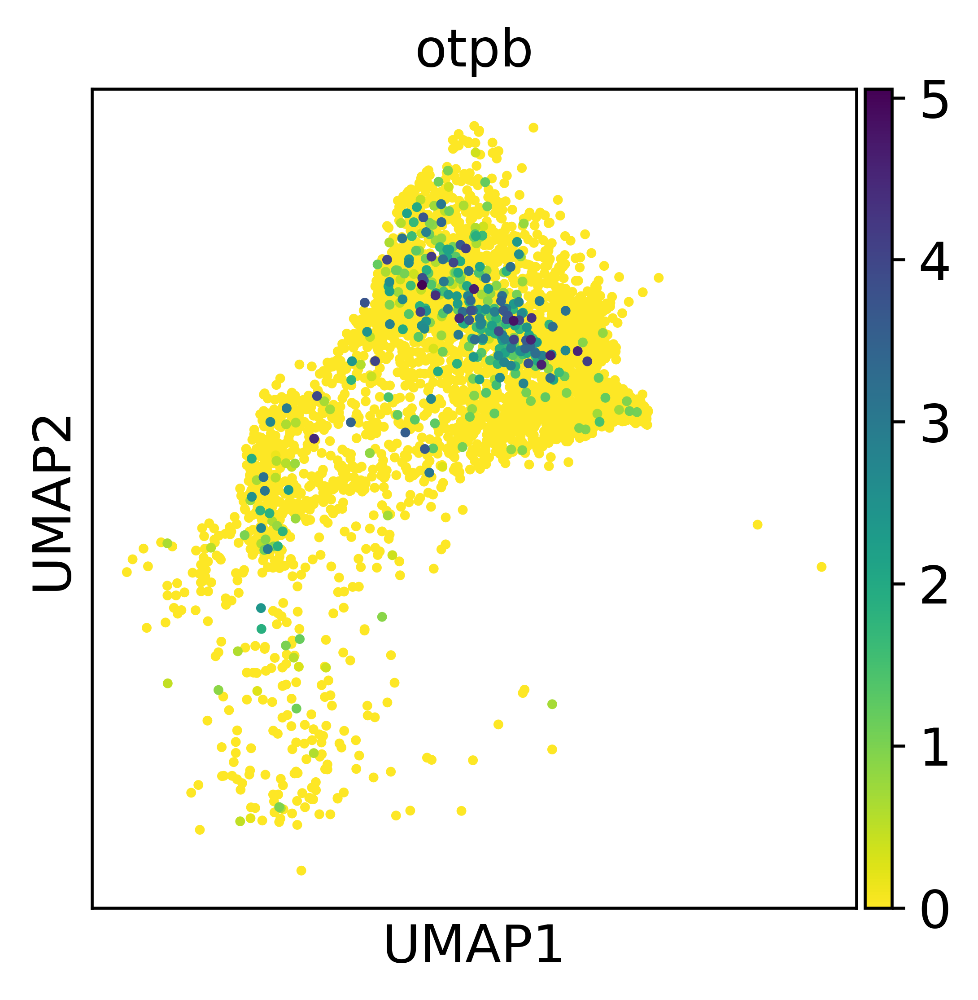

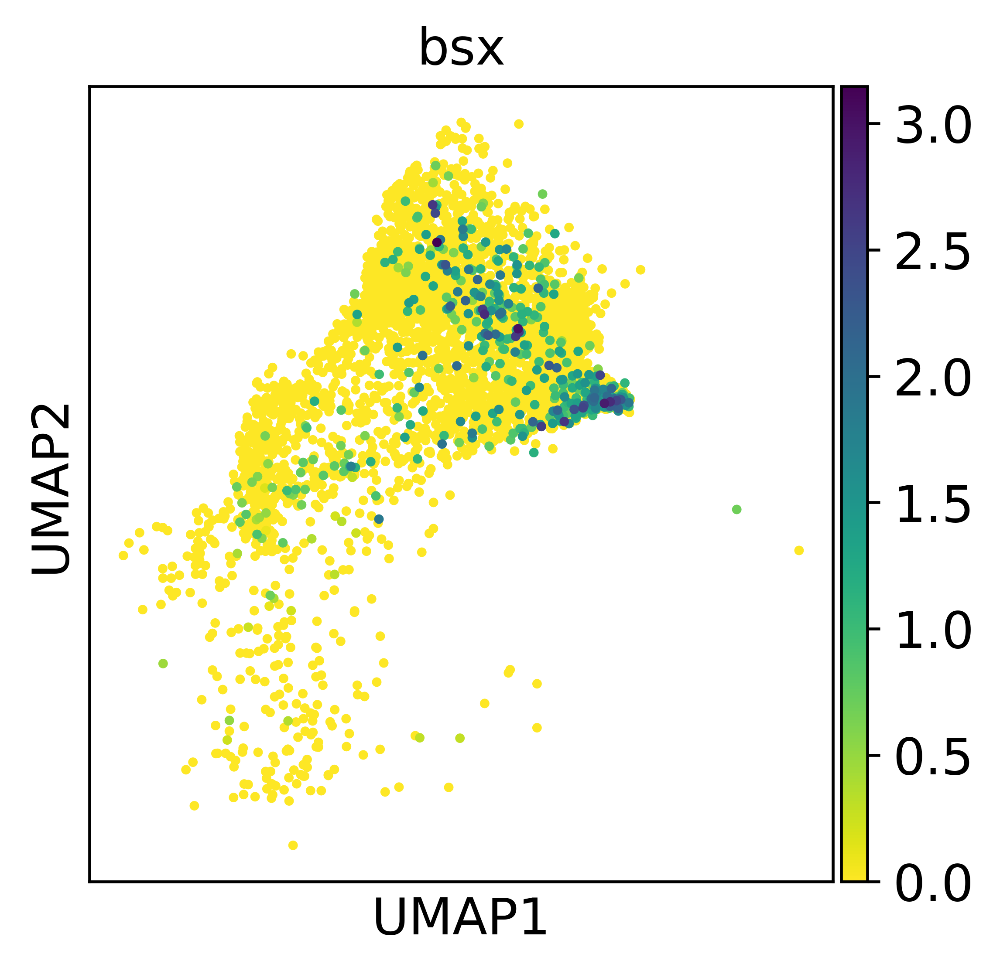

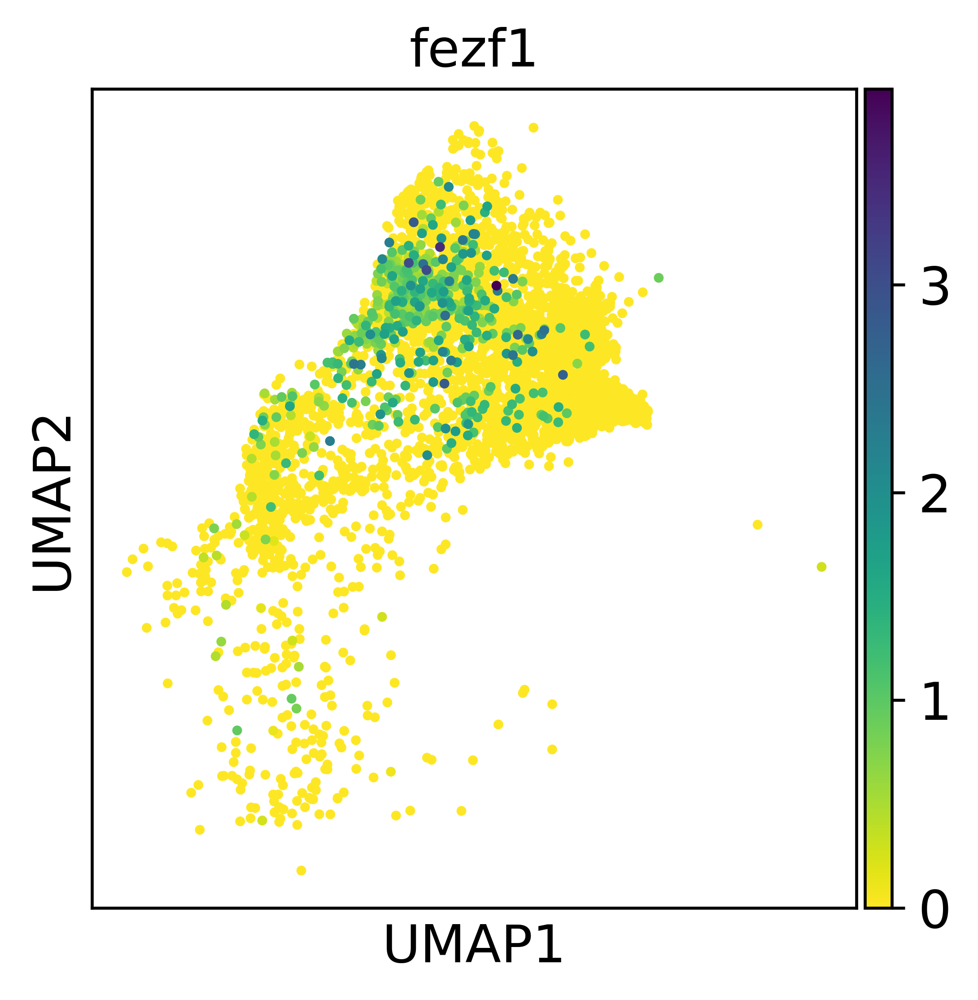

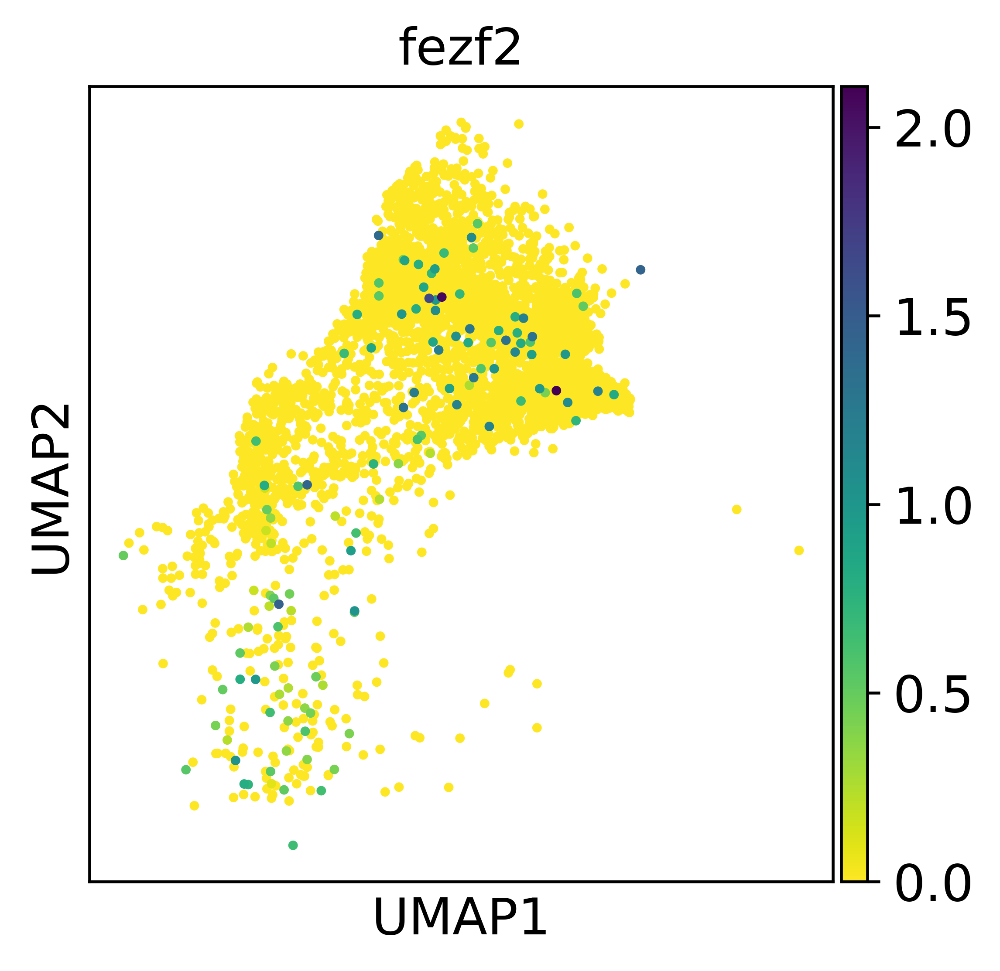

In [ ]:
for x in ["hmx2","hmx3a", "otpa", "otpb", "bsx", "fezf1","fezf2", "nkx2.1","six3a","six3b", "six6a", "six6b","rx1","rx2" ,"rx3",
                          "sfrp1a","sfrp1b","fzd8a","fzd8b","sfrp5","otx2","otx1a","otx1b","otx5","lhx2a", "lhx2b", "lhx9", "dkk1a", "dkk1b", 
                           "dkk3a","dkk3b"]:
    
    sc.pl.umap(zeb_hypo,color=x, color_map="viridis_r",save="_" + x + ".pdf")
    



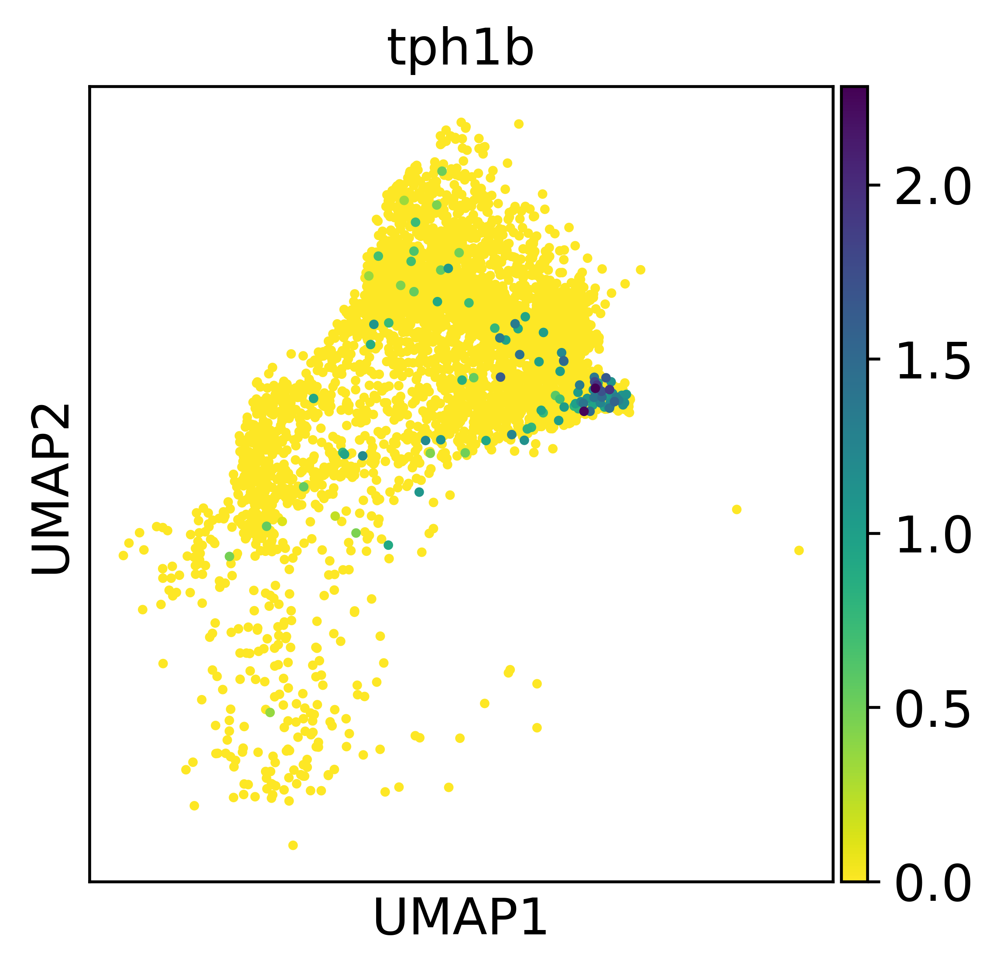

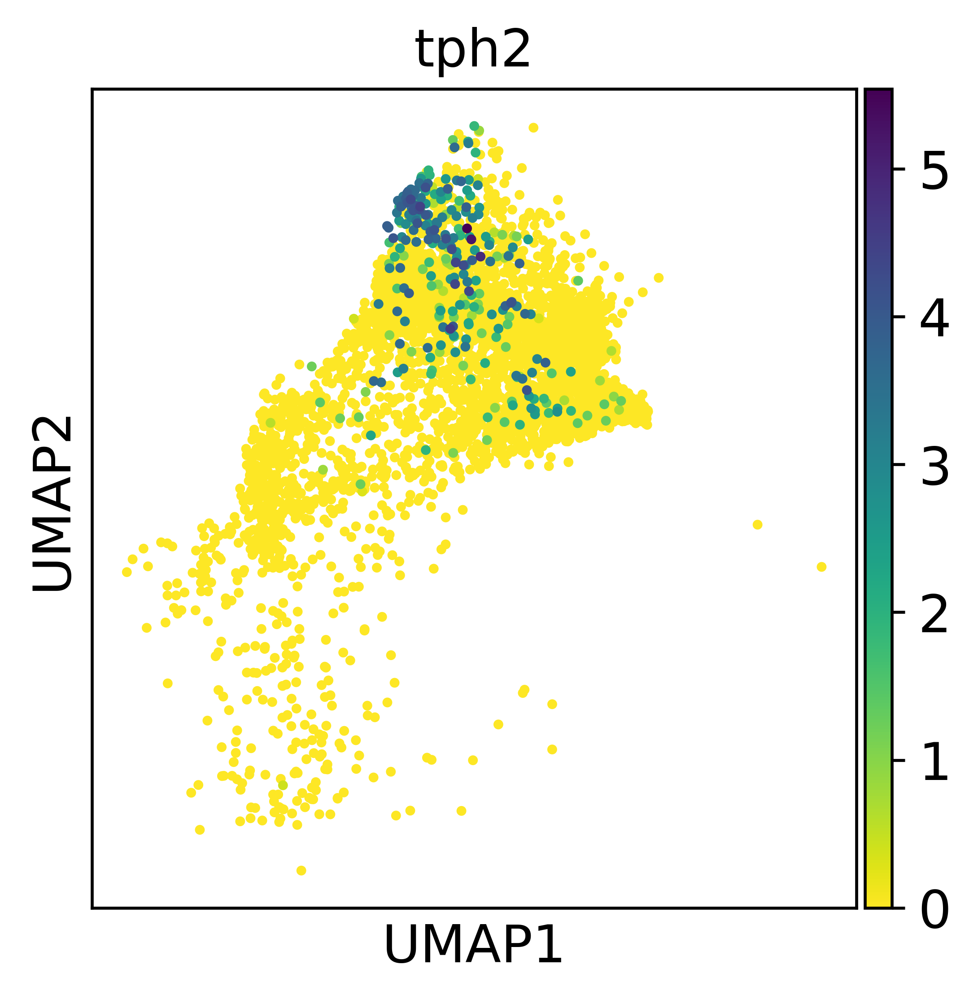

In [139]:
sc.pl.umap(zeb_hypo,color=["tph1b"], color_map="viridis_r",save="_tph1b.pdf")
sc.pl.umap(zeb_hypo,color=["tph2"], color_map="viridis_r",save="_tph2.pdf")

In [126]:
zeb_dc = zeb_data[zeb_data.obs["broad_celltype"].isin(["Hypothalamus","Diencephalon"]),]
zeb_dc

/hps/software/users/marioni/dkeitley/miniconda3/envs/pyenv/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


View of AnnData object with n_obs × n_vars = 23505 × 15466
    obs: 'orig.ident', 'stage', 'cluster', 'celltype', 'celltype_markers', 'sizeFactor', 'broad_celltype'
    uns: 'celltype_colors', 'stage_colors', 'broad_celltype_colors'
    obsm: 'X_pca', 'X_umap'

Trying to set attribute `.uns` of view, copying.


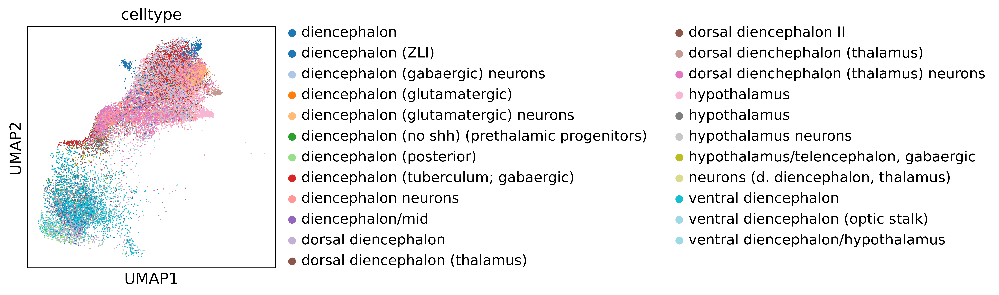

In [127]:
sc.pl.umap(zeb_dc,color=["celltype"],palette="tab20")